In [109]:
import pandas as pd
import numpy as np
from sklearn import preprocessing as pp

# parse features and labels for train and test data
def parse_data(fpath):
    df = pd.read_csv(fpath, header=None)
    features = df.iloc[:,1:]
    labels = df.iloc[:,0]
    return np.array(features), np.array(labels)

train_feat_path = 'data/features_train/features_resnet1000_train.csv'
test_feat_path = 'data/features_test/features_resnet1000_test.csv'

train_features, train_labels = parse_data(train_feat_path)
test_features, test_labels = parse_data(test_feat_path)

In [115]:
import glob
import re
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer 
from nltk.corpus import stopwords

# preprocess descriptions to remove noises
def preprocess_descriptions(fpath):
    lmt = WordNetLemmatizer()
    stemmer = PorterStemmer()
    descriptions = []
    
    for fname in glob.glob(fpath):
        file = open(fname, 'r')
        desc = file.read()
        desc = np.char.lower(desc)

        # replace punctuations in each set of descriptions
        desc = re.sub('[^\w\s]', ' ' , str(desc))

        words = []
        for i, word in enumerate(desc.split()):
            # if not stopword, lemmatize and stem word
            if word not in stopwords.words('english'):
                word = lmt.lemmatize(word)
                words.append(stemmer.stem(word))
        description = ' '.join(words)
        image_idx = int(fname.split('/')[-1].split('.')[0])
        descriptions.insert(image_idx, description)
    return descriptions

train_desc_fpath = 'data/descriptions_train/*.txt'
test_desc_fpath = 'data/descriptions_test/*.txt'

train_desc = preprocess_descriptions(train_desc_fpath)
test_desc = preprocess_descriptions(test_desc_fpath)


In [116]:
# build bag of words for descriptions
def build_bag_of_words(descriptions):
    word_dict = {}
    unique_words = []
    desc_feat = []
    
    #build a list of unique words from train descriptions
    for desc in train_desc:
        for word in desc.split():
            if word in word_dict:
                word_dict[word] += 1
            else:
                word_dict[word] = 1

    # include words with counts > 10
    unique_words = [k for k,v in word_dict.items() if v > 10]
                
    # for each description, create a feature vector with ith index as the count of ith word in the word list
    for desc in descriptions:
        feat = [0] * len(unique_words) 
        for word in desc.split():
            if word in unique_words:
                feat[unique_words.index(word)] += 1
        desc_feat.append(feat)

    print(unique_words)
    return np.array(desc_feat)

train_desc_feat, test_desc_feat = [], []
train_desc_feat = build_bag_of_words(train_desc)
test_desc_feat = build_bag_of_words(test_desc)

['skateboard', 'put', 'show', 'use', 'picnic', 'tabl', 'stage', 'pull', 'trick', 'top', 'man', 'ride', 'skate', 'boarder', 'person', 'crowd', 'watch', 'bowl', 'soup', 'carrot', 'noodl', 'food', 'readi', 'eat', 'sit', 'next', 'tasti', 'serv', 'someon', 'enjoy', 'asian', 'walk', 'across', 'street', 'busi', 'intersect', 'ice', 'cream', 'truck', 'drive', 'behind', 'cross', 'near', 'bu', 'young', 'boy', 'throw', 'frisbe', 'grassi', 'field', 'park', 'tree', 'line', 'kid', 'citi', 'bright', 'green', 'grass', 'child', 'yard', 'hold', 'bat', 'back', 'basebal', 'littl', 'black', 'cloth', 'shoulder', 'fenc', 'play', 'small', 'bedroom', 'desk', 'comput', 'chair', 'bed', 'front', 'brown', 'besid', 'window', 'big', 'donut', 'fed', 'anoth', 'hand', 'blond', 'look', 'hole', 'doughnut', 'powder', 'sugar', 'face', 'power', 'cover', 'flood', 'part', 'frost', 'stand', 'wood', 'wear', 'hat', 'glass', 'sunglass', 'tie', 'crown', 'blue', 'shirt', 'weird', 'around', 'brick', 'build', 'sign', 'right', 'outsid'

['skateboard', 'put', 'show', 'use', 'picnic', 'tabl', 'stage', 'pull', 'trick', 'top', 'man', 'ride', 'skate', 'boarder', 'person', 'crowd', 'watch', 'bowl', 'soup', 'carrot', 'noodl', 'food', 'readi', 'eat', 'sit', 'next', 'tasti', 'serv', 'someon', 'enjoy', 'asian', 'walk', 'across', 'street', 'busi', 'intersect', 'ice', 'cream', 'truck', 'drive', 'behind', 'cross', 'near', 'bu', 'young', 'boy', 'throw', 'frisbe', 'grassi', 'field', 'park', 'tree', 'line', 'kid', 'citi', 'bright', 'green', 'grass', 'child', 'yard', 'hold', 'bat', 'back', 'basebal', 'littl', 'black', 'cloth', 'shoulder', 'fenc', 'play', 'small', 'bedroom', 'desk', 'comput', 'chair', 'bed', 'front', 'brown', 'besid', 'window', 'big', 'donut', 'fed', 'anoth', 'hand', 'blond', 'look', 'hole', 'doughnut', 'powder', 'sugar', 'face', 'power', 'cover', 'flood', 'part', 'frost', 'stand', 'wood', 'wear', 'hat', 'glass', 'sunglass', 'tie', 'crown', 'blue', 'shirt', 'weird', 'around', 'brick', 'build', 'sign', 'right', 'outsid'

In [117]:
from sklearn import preprocessing as pp

def post_process_descriptions(desc_feat):
    desc_feat = pp.normalize(desc_feat, norm='l2')
    return desc_feat

train_desc_feat = post_process_descriptions(train_desc_feat)
test_desc_feat = post_process_descriptions(test_desc_feat)

/Users/yuniemao/anaconda/lib/python3.6/site-packages/sklearn/utils/validation.py:429: DataConversionWarning: Data with input dtype int64 was converted to float64 by the normalize function.
  warnings.warn(msg, _DataConversionWarning)


In [113]:
# build map of train features to their image labels
def create_train_features_map():
    image_features_dict = {}
    for i, feat in enumerate(train_features):
        image_name = train_labels[i]
        image_idx = int(image_name.split('/')[1].split('.')[0])
        image_features_dict[image_idx] = feat
    return image_features_dict

image_features_dict = create_train_features_map()


In [118]:
from sklearn.neighbors import KNeighborsClassifier 

# train KNeighborsClassifier to fit training description feature to their image labels
def train_KNN():
    knn = KNeighborsClassifier(n_neighbors=1)

    knn.fit(train_desc_feat, np.array(range(10000)))

    # find closest training image for test description features
    pred = knn.predict(test_desc_feat)
    return pred

predictions = train_KNN()
print(predictions)

[3037 8242 8813 ..., 9300 2814 8776]


woman walk street past doorway woman walk past doorway sidewalk woman talk cell phone check watch woman talk cell phone check watch walk sidewalk woman wear blue phone walk along sidewalk front build black planter side entranc ['222.jpg', '105.jpg', '1980.jpg', '1396.jpg', '829.jpg', '106.jpg', '1883.jpg', '309.jpg', '82.jpg', '279.jpg', '1623.jpg', '333.jpg', '1627.jpg', '305.jpg', '597.jpg', '1581.jpg', '1144.jpg', '46.jpg', '669.jpg', '1886.jpg']


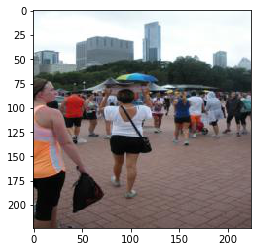

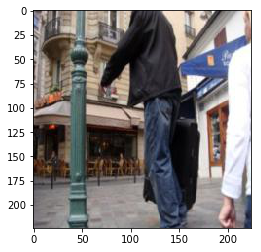

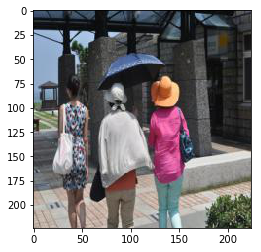

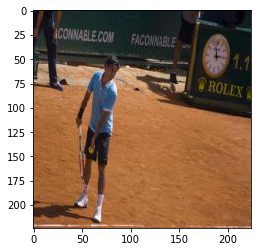

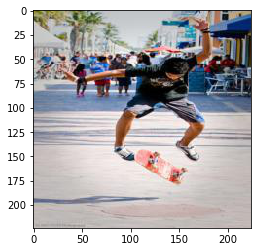

...

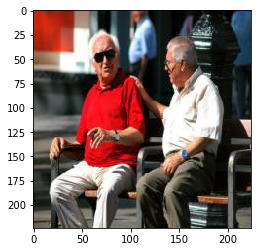

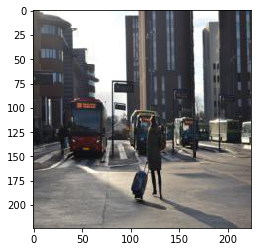

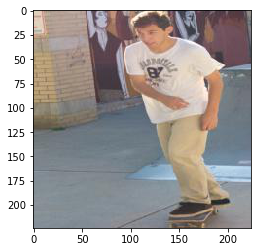

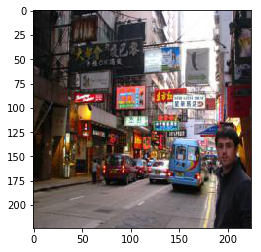

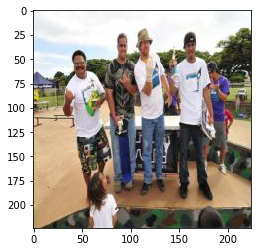

larg slice angel food cake sit top plate small plate contain larg slice cake quarter cake plate larg piec yellow cake sit plate larg slab spong cake sit upon floweri plate ['1714.jpg', '589.jpg', '14.jpg', '753.jpg', '885.jpg', '1806.jpg', '457.jpg', '1809.jpg', '1054.jpg', '1929.jpg', '200.jpg', '833.jpg', '331.jpg', '1199.jpg', '1733.jpg', '1550.jpg', '355.jpg', '1753.jpg', '1507.jpg', '1812.jpg']


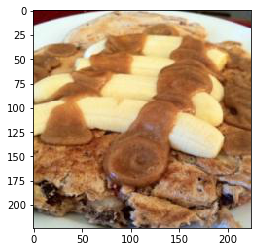

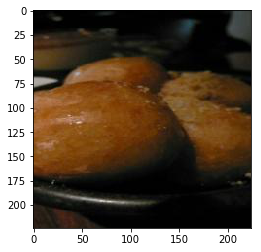

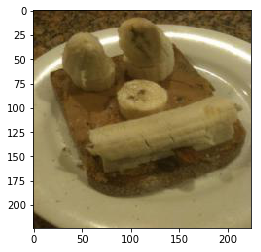

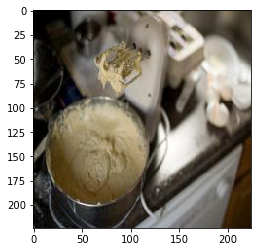

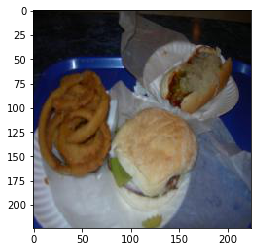

...

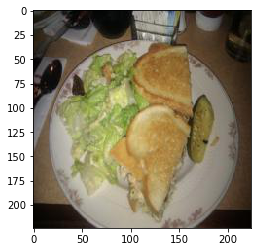

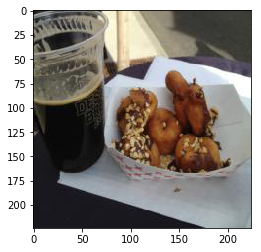

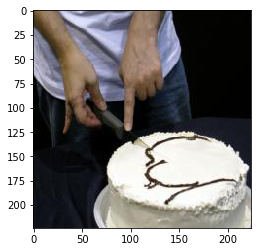

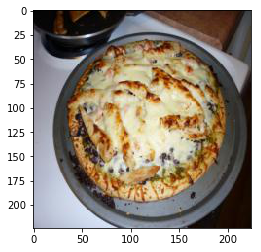

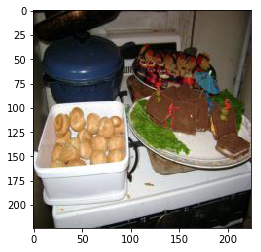

group traffic light sit intersect sign shine street light pictur stoplight window sun surround airplan traffic light sever street light airplan fli overhead ['838.jpg', '1724.jpg', '634.jpg', '1183.jpg', '159.jpg', '696.jpg', '579.jpg', '1840.jpg', '445.jpg', '600.jpg', '1471.jpg', '825.jpg', '904.jpg', '953.jpg', '42.jpg', '720.jpg', '1866.jpg', '496.jpg', '1107.jpg', '511.jpg']


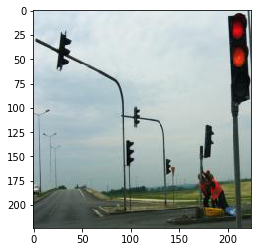

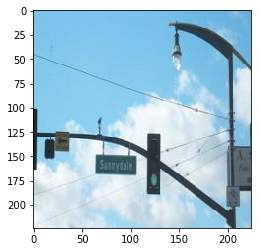

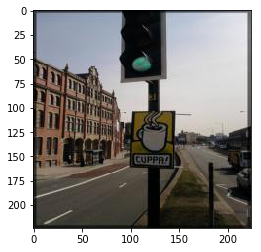

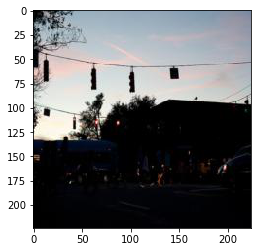

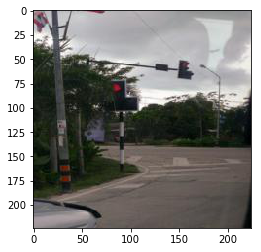

...

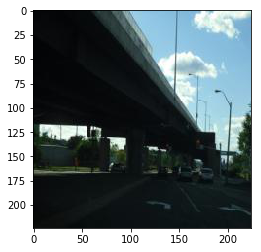

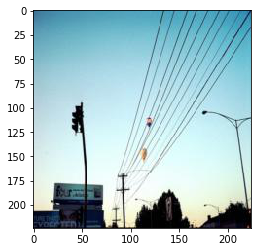

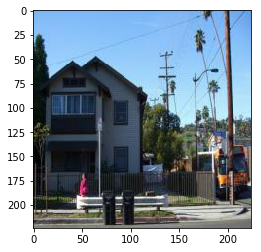

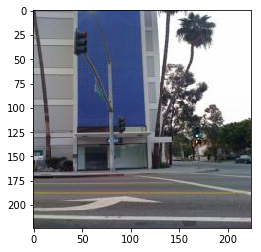

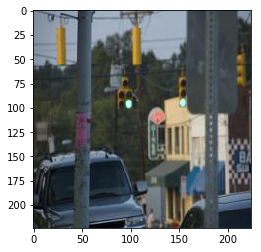

two mean uniform ride hors side side sandi beach two polic offic hors ride beach two peopl ride hors middl lot pair polic offic ride hors beach two peopl neon vest ride hors beach ['1035.jpg', '1609.jpg', '1315.jpg', '1513.jpg', '75.jpg', '1769.jpg', '1850.jpg', '243.jpg', '66.jpg', '1755.jpg', '90.jpg', '1486.jpg', '397.jpg', '799.jpg', '1404.jpg', '1185.jpg', '1818.jpg', '654.jpg', '1394.jpg', '432.jpg']


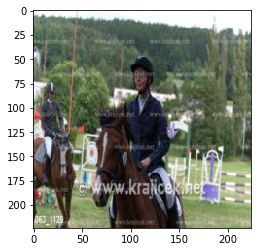

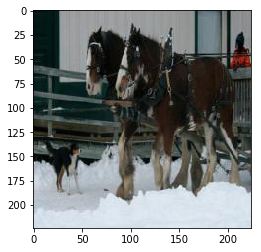

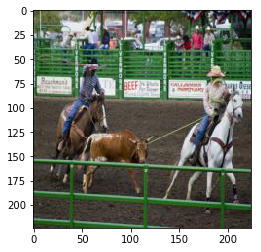

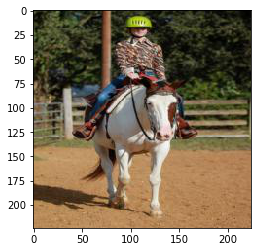

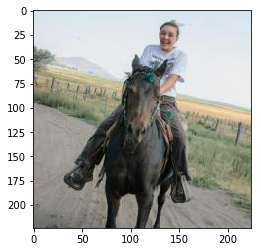

...

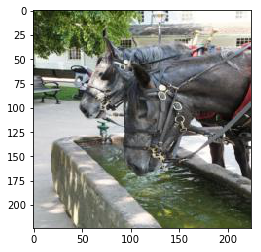

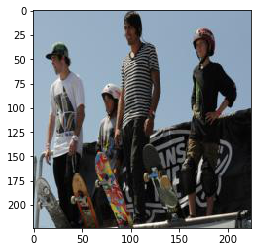

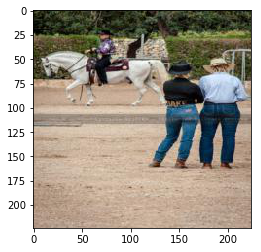

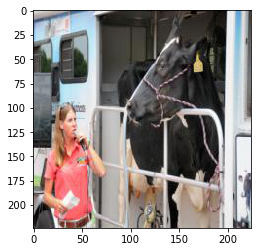

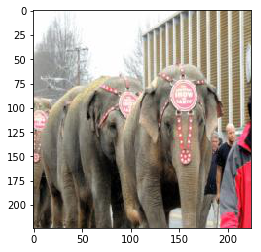

man woman use pay phone adjac booth adult use pay telephon outdoor stand next soda machin coupl peopl phone stand togeth man woman talk public pay phone coupl peopl talk phone ['375.jpg', '1003.jpg', '995.jpg', '1388.jpg', '1561.jpg', '292.jpg', '434.jpg', '736.jpg', '1131.jpg', '21.jpg', '978.jpg', '1105.jpg', '1856.jpg', '484.jpg', '336.jpg', '1451.jpg', '1135.jpg', '862.jpg', '1219.jpg', '939.jpg']


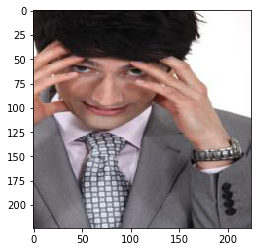

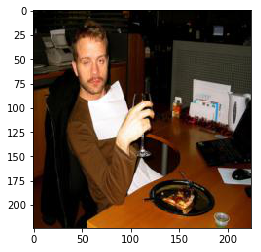

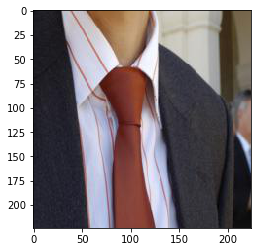

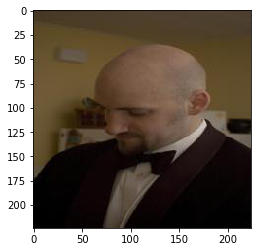

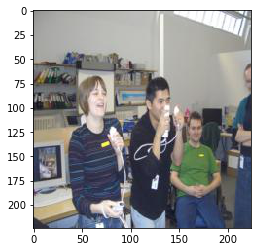

...

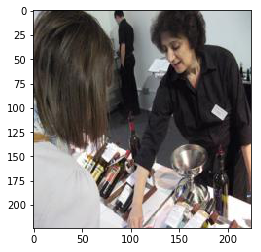

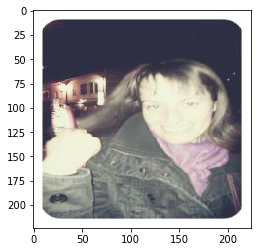

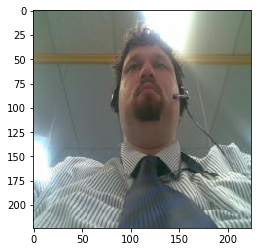

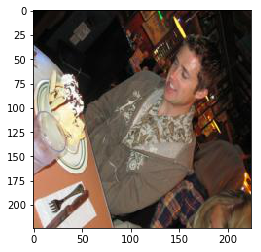

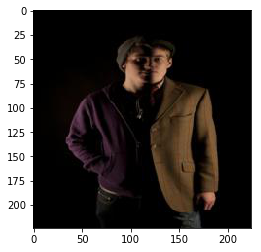

In [217]:
import scipy as sp
import operator
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity as cos

def get_dist(feat1, feat2):
    dist = sp.spatial.distance.cdist(feat1.reshape(1, -1), feat2.reshape(1, -1), 'euclidean').flatten()
    return dist[0]


def get_dist2(feat1, feat2):
    dist = sp.spatial.distance.cdist(feat1.reshape(1, -1), feat2.reshape(1, -1), 'cosine').flatten()
    return dist[0]


def get_top_20_images(desc_idx):
    top_images = []
    # predict train image index for 
    pred = predictions[desc_idx]
    # get training feature vector for predicted training image
    train_feat = image_features_dict[pred]
    feat_score = {} # map of test label to dist with train features
    for i, test_feat in enumerate(test_features):
        # compare test feature with train feature
        score = get_dist2(train_feat, test_feat)
        feat_score[test_labels[i]] = score
    #print(feat_score)
    sorted_feat_score = sorted(feat_score.items(), key=operator.itemgetter(1))
    for k,v in sorted_feat_score[:20]:
        top_images.append(k.split('/')[1])
    return top_images
    
    
for i, desc in enumerate(test_desc[:5]):
    top = get_top_20_images(i)
    print(desc, get_top_20_images(i))
    for image in top:
        img = Image.open('data/images_test/' + image)
        img = np.asarray(img)
        plt.imshow(img)
        plt.show()

In [218]:
import csv

def write_submissions(output_filename, is_image_to_desc):
    output_file = open(output_filename, "w")
    writer = csv.writer(output_file)
    #write headers
    writer.writerow(["Descritpion_ID", "Top_20_Image_IDs"])
    # get top 20 images for each test description
    for i, desc_feat in enumerate(test_desc_feat):
        if (is_image_to_desc):
            top_20_images = get_top_20_images_desc(desc_feat)
        else:
            top_20_images = get_top_20_images(i)
        images = " ".join(top_20_images)
        writer.writerow([str(i) + '.txt', images])


write_submissions('sample_submission.csv', False)

In [ ]:
##### Image to Description Approach Below
#####

In [221]:
def image_to_desc_feat():
    # map of test label to aggregated description features
    test_label_agg_desc = {}
    dist_matrix = sp.spatial.distance.cdist(test_features, train_features, 'cosine')
    
    for i in range(dist_matrix.shape[0]):
        # find row indices of the lowest values, the indices for closest images in train features
        # append to list train_image_idx
        train_feat_idx = dist_matrix[i].argsort()[:2]
        train_image_idx = []
        # for each train feature index, find corresponding train image file 
        for j in train_feat_idx:
            train_image = int(train_labels[j].split('/')[1].split('.')[0])
            train_image_idx.append(train_image)
        print(test_labels[i], train_image_idx)
        test_label_agg_desc[test_labels[i]] = get_agg_desc_feat(train_image_idx)
    return test_label_agg_desc
            

# create aggregated description matrix by adding closest train description feature vectors
def get_agg_desc_feat(train_image_idx):
    agg_desc_feat = [0] * (train_desc_feat.shape[1])
    for image_idx in train_image_idx:
        agg_desc_feat += train_desc_feat[image_idx]
    return agg_desc_feat    
        
    
test_label_agg_desc = image_to_desc_feat() 
print(test_label_agg_desc)

images_test/152.jpg [8140, 2731, 5713]
images_test/901.jpg [2978, 8868, 3550]
images_test/1609.jpg [6537, 3407, 5820]
images_test/501.jpg [4868, 2525, 8669]
images_test/517.jpg [3912, 3476, 6498]
images_test/1822.jpg [1006, 3115, 3463]
images_test/1993.jpg [9316, 4185, 5519]
images_test/832.jpg [9362, 1358, 258]
images_test/1462.jpg [8442, 5309, 1285]
images_test/1718.jpg [6997, 2412, 6793]
images_test/1303.jpg [8253, 6011, 8240]
images_test/874.jpg [4749, 8954, 3139]
images_test/1507.jpg [7378, 3093, 7199]
images_test/858.jpg [4443, 6280, 1143]
images_test/1722.jpg [1664, 1661, 9226]
images_test/1169.jpg [2873, 2240, 4949]
images_test/261.jpg [1446, 7536, 1845]
images_test/1756.jpg [3442, 3853, 1955]
images_test/725.jpg [2318, 5521, 4762]
images_test/1209.jpg [8633, 2083, 7355]
images_test/1005.jpg [7571, 7066, 2385]
images_test/1381.jpg [691, 62, 8162]
images_test/1162.jpg [4961, 5495, 1325]
images_test/1548.jpg [4443, 377, 4783]
images_test/1943.jpg [7434, 3788, 7953]
images_test/42

images_test/1846.jpg [2454, 6816, 8863]
images_test/1647.jpg [209, 6874, 1103]
images_test/578.jpg [4918, 2523, 2359]
images_test/1670.jpg [8512, 767, 6699]
images_test/179.jpg [5837, 9702, 1559]
images_test/1606.jpg [769, 5411, 543]
images_test/232.jpg [4497, 8015, 3510]
images_test/657.jpg [2780, 577, 6178]
images_test/92.jpg [2458, 1250, 2560]
images_test/1280.jpg [3955, 6117, 9009]
images_test/627.jpg [5225, 8456, 786]
images_test/1708.jpg [4470, 4351, 6703]
images_test/1435.jpg [882, 9558, 3941]
images_test/636.jpg [2453, 8978, 1525]
images_test/62.jpg [8512, 6387, 1187]
images_test/348.jpg [3115, 544, 4811]
images_test/1847.jpg [8897, 6749, 1639]
images_test/1920.jpg [5065, 4919, 8047]
images_test/922.jpg [9669, 7066, 7186]
images_test/148.jpg [994, 7104, 8950]
images_test/222.jpg [4870, 6794, 3037]
images_test/329.jpg [569, 5429, 4399]
images_test/402.jpg [6598, 7067, 4942]
images_test/978.jpg [2462, 1240, 927]
images_test/796.jpg [3260, 2981, 7811]
images_test/1877.jpg [9662, 7

images_test/1138.jpg [8131, 8434, 6472]
images_test/237.jpg [3794, 8757, 9541]
images_test/1727.jpg [4127, 533, 5475]
images_test/61.jpg [8538, 2536, 2436]
images_test/1574.jpg [8080, 9965, 4128]
images_test/1371.jpg [6570, 371, 742]
images_test/134.jpg [4886, 4081, 4118]
images_test/110.jpg [7216, 8119, 3122]
images_test/1176.jpg [3816, 4124, 5650]
images_test/24.jpg [7119, 6096, 2387]
images_test/1396.jpg [2272, 8406, 7006]
images_test/972.jpg [7458, 6619, 8045]
images_test/155.jpg [441, 1699, 3830]
images_test/257.jpg [3044, 923, 7387]
images_test/1205.jpg [1376, 8093, 6890]
images_test/1672.jpg [4397, 9030, 4805]
images_test/1663.jpg [1173, 3196, 8143]
images_test/1918.jpg [1623, 5627, 7756]
images_test/11.jpg [1069, 8253, 3344]
images_test/1914.jpg [7673, 198, 4520]
images_test/1953.jpg [3282, 5325, 5878]
images_test/1812.jpg [8413, 2094, 62]
images_test/182.jpg [5883, 1281, 472]
images_test/0.jpg [962, 3352, 135]
images_test/1884.jpg [3745, 6339, 9316]
images_test/837.jpg [9948, 

images_test/1361.jpg [9425, 6601, 8887]
images_test/31.jpg [4027, 9053, 9762]
images_test/214.jpg [515, 4590, 5748]
images_test/167.jpg [3521, 2840, 2170]
images_test/1621.jpg [7918, 2422, 4997]
images_test/1923.jpg [2651, 9403, 2275]
images_test/1040.jpg [9797, 3363, 4058]
images_test/1016.jpg [9673, 4352, 2495]
images_test/4.jpg [4541, 1415, 6468]
images_test/428.jpg [1899, 9902, 4114]
images_test/1888.jpg [4149, 8528, 7948]
images_test/1210.jpg [1254, 6581, 1057]
images_test/407.jpg [3974, 1632, 2419]
images_test/942.jpg [421, 6523, 4428]
images_test/1786.jpg [4118, 1656, 5168]
images_test/1691.jpg [4635, 2638, 3416]
images_test/1188.jpg [151, 7221, 8512]
images_test/452.jpg [3221, 9231, 9333]
images_test/1161.jpg [9362, 6549, 2537]
images_test/1172.jpg [1043, 7510, 9245]
images_test/1776.jpg [7686, 7434, 1437]
images_test/133.jpg [3253, 6623, 5764]
images_test/1526.jpg [4693, 8475, 3665]
images_test/17.jpg [7791, 9004, 4432]
images_test/1982.jpg [3629, 7173, 3334]
images_test/18.jp

images_test/1154.jpg [4562, 7913, 9201]
images_test/699.jpg [9351, 6989, 7247]
images_test/105.jpg [7015, 3047, 6984]
images_test/702.jpg [3694, 2901, 90]
images_test/1568.jpg [4981, 7330, 3432]
images_test/684.jpg [5989, 3911, 2402]
images_test/795.jpg [610, 5333, 1241]
images_test/1946.jpg [2659, 8907, 6043]
images_test/952.jpg [9485, 9962, 1427]
images_test/612.jpg [6684, 1037, 860]
images_test/850.jpg [4114, 7191, 8762]
images_test/583.jpg [8017, 6702, 4819]
images_test/1586.jpg [3697, 823, 3739]
images_test/81.jpg [8150, 2077, 2461]
images_test/1723.jpg [5862, 5674, 8987]
images_test/1576.jpg [595, 335, 6140]
images_test/948.jpg [3799, 2116, 7502]
images_test/1978.jpg [3927, 8285, 2546]
images_test/1801.jpg [7557, 5226, 6130]
images_test/119.jpg [4084, 864, 1069]
images_test/1747.jpg [1820, 5519, 9316]
images_test/1939.jpg [523, 4117, 6011]
images_test/907.jpg [3692, 6446, 3389]
images_test/1444.jpg [7637, 2455, 9342]
images_test/363.jpg [8229, 5632, 4239]
images_test/1839.jpg [82

images_test/1487.jpg [16, 9994, 7468]
images_test/496.jpg [5113, 928, 8351]
images_test/1631.jpg [6151, 6139, 5287]
images_test/1355.jpg [8752, 9754, 8836]
images_test/1615.jpg [62, 4077, 2828]
images_test/968.jpg [6205, 333, 6295]
images_test/1719.jpg [4862, 1482, 4664]
images_test/1102.jpg [7199, 5583, 2698]
images_test/468.jpg [1517, 1817, 1234]
images_test/1746.jpg [8953, 2787, 8571]
images_test/118.jpg [1149, 3931, 7102]
images_test/1315.jpg [4394, 3123, 9111]
images_test/1279.jpg [148, 6433, 5444]
images_test/1721.jpg [984, 5920, 5759]
images_test/802.jpg [2502, 7692, 7665]
images_test/767.jpg [6915, 3033, 2802]
images_test/1833.jpg [9610, 5288, 5414]
images_test/902.jpg [5023, 134, 9370]
images_test/212.jpg [7287, 915, 4642]
images_test/1449.jpg [4904, 7865, 6431]
images_test/1628.jpg [8216, 5332, 4985]
images_test/650.jpg [5491, 4400, 6106]
images_test/1170.jpg [4431, 2497, 3082]
images_test/1194.jpg [1703, 6056, 861]
images_test/1267.jpg [4644, 5836, 6694]
images_test/513.jpg 

images_test/782.jpg [4687, 8409, 9838]
images_test/1183.jpg [2878, 8132, 2662]
images_test/115.jpg [949, 3244, 6198]
images_test/962.jpg [681, 9085, 6123]
images_test/748.jpg [7807, 3150, 4795]
images_test/1383.jpg [4494, 368, 3957]
images_test/965.jpg [1387, 3169, 3094]
images_test/163.jpg [1899, 1045, 1298]
images_test/1471.jpg [5503, 6030, 278]
images_test/808.jpg [997, 582, 3054]
images_test/1934.jpg [6141, 6314, 9710]
images_test/415.jpg [4073, 1794, 4153]
images_test/403.jpg [7203, 5082, 4895]
images_test/1629.jpg [7066, 6359, 7186]
images_test/124.jpg [9930, 9938, 4411]
images_test/839.jpg [9200, 3272, 4378]
images_test/1105.jpg [50, 2736, 598]
images_test/141.jpg [6549, 7784, 7771]
images_test/1792.jpg [9414, 1257, 3668]
images_test/1.jpg [6673, 5901, 7401]
images_test/1225.jpg [9802, 9473, 241]
images_test/1079.jpg [522, 9050, 7327]
images_test/543.jpg [5516, 9287, 3024]
images_test/504.jpg [4120, 8979, 3134]
images_test/918.jpg [3894, 1196, 6141]
images_test/622.jpg [8572, 58

images_test/165.jpg [5827, 9306, 8199]
images_test/1967.jpg [6216, 6313, 2342]
images_test/208.jpg [2577, 3346, 2643]
images_test/511.jpg [8344, 725, 4710]
images_test/1372.jpg [6056, 7204, 4866]
images_test/1690.jpg [6951, 7934, 6338]
images_test/1252.jpg [227, 3476, 8572]
images_test/869.jpg [3269, 2023, 6427]
images_test/741.jpg [7272, 4521, 5865]
images_test/992.jpg [6145, 8497, 7707]
images_test/1750.jpg [4460, 5684, 2881]
images_test/542.jpg [8578, 5313, 2021]
images_test/458.jpg [1050, 5073, 8687]
images_test/360.jpg [2166, 939, 7295]
images_test/1068.jpg [1319, 1102, 6041]
images_test/79.jpg [7966, 1948, 5926]
images_test/1627.jpg [73, 6636, 118]
images_test/1675.jpg [3178, 3192, 5211]
images_test/436.jpg [732, 5116, 9669]
images_test/1777.jpg [2520, 6950, 4431]
images_test/1682.jpg [3137, 401, 9903]
images_test/1880.jpg [62, 7270, 1899]
images_test/761.jpg [414, 5904, 6666]
images_test/318.jpg [1405, 2918, 1429]
images_test/1010.jpg [2695, 5072, 3233]
images_test/1143.jpg [604

images_test/1291.jpg [3459, 884, 1840]
images_test/1658.jpg [1405, 9423, 4899]
images_test/224.jpg [4258, 4269, 4706]
images_test/401.jpg [5758, 2977, 5261]
images_test/1660.jpg [7245, 5441, 4248]
images_test/568.jpg [3122, 1704, 2900]
images_test/1984.jpg [6319, 5052, 6035]
images_test/631.jpg [2470, 7552, 563]
images_test/1539.jpg [8225, 9262, 322]
images_test/665.jpg [2794, 4084, 8049]
images_test/529.jpg [8162, 3128, 1221]
images_test/609.jpg [9797, 4677, 2887]
images_test/982.jpg [956, 7363, 9545]
images_test/1619.jpg [4849, 7204, 2301]
images_test/856.jpg [4634, 4056, 7465]
images_test/50.jpg [5468, 5623, 7542]
images_test/775.jpg [8899, 1495, 7041]
images_test/1906.jpg [2836, 4592, 2815]
images_test/1688.jpg [8710, 9848, 1796]
images_test/204.jpg [2563, 5949, 3889]
images_test/136.jpg [628, 115, 3856]
images_test/1384.jpg [4401, 6565, 111]
images_test/1275.jpg [722, 6910, 5441]
images_test/1274.jpg [823, 7776, 8591]
images_test/1251.jpg [6790, 4815, 3995]
images_test/453.jpg [95

In [203]:
def show_agg_desc():
    # print out aggregated descriptions constructed from sim to train features
    word_dict = ['skateboard', 'put', 'show', 'use', 'picnic', 'tabl', 'stage', 'pull', 'trick', 'top', 'man', 'ride', 'skate', 'boarder', 'person', 'crowd', 'watch', 'bowl', 'soup', 'carrot', 'noodl', 'food', 'readi', 'eat', 'sit', 'next', 'tasti', 'serv', 'someon', 'enjoy', 'asian', 'walk', 'across', 'street', 'busi', 'intersect', 'ice', 'cream', 'truck', 'drive', 'behind', 'cross', 'near', 'bu', 'young', 'boy', 'throw', 'frisbe', 'grassi', 'field', 'park', 'tree', 'line', 'kid', 'citi', 'bright', 'green', 'grass', 'child', 'yard', 'hold', 'bat', 'back', 'basebal', 'littl', 'black', 'cloth', 'shoulder', 'fenc', 'play', 'small', 'bedroom', 'desk', 'comput', 'chair', 'bed', 'front', 'brown', 'besid', 'window', 'big', 'donut', 'fed', 'anoth', 'hand', 'blond', 'look', 'hole', 'doughnut', 'powder', 'sugar', 'face', 'power', 'cover', 'flood', 'part', 'frost', 'stand', 'wood', 'wear', 'hat', 'glass', 'sunglass', 'tie', 'crown', 'blue', 'shirt', 'weird', 'around', 'brick', 'build', 'sign', 'right', 'outsid', 'white', 'imag', 'empti', 'old', 'pictur', 'tent', 'forest', 'silver', 'site', 'trailer', 'road', 'two', 'motor', 'home', 'photo', 'bunch', 'luggag', 'lay', 'area', 'rug', 'sever', 'piec', 'floor', 'travel', 'bag', 'carpet', 'crust', 'bake', 'berri', 'pie', 'strawberri', 'file', 'good', 'close', 'cook', 'fruit', 'muffin', 'sort', 'display', 'clear', 'view', 'traffic', 'light', 'juic', 'red', 'hang', 'signal', 'electr', 'post', 'read', 'cat', 'sleep', 'insid', 'orang', 'curtain', 'dog', 'pack', 'men', 'larg', 'jet', 'peopl', 'plane', 'land', 'path', 'runway', 'strip', 'airplan', 'take', 'group', 'ski', 'snow', 'famili', 'other', 'clean', 'car', 'go', 'snowi', 'middl', 'coupl', 'guy', 'wii', 'togeth', 'adult', 'video', 'game', 'control', 'live', 'room', 'remot', 'boat', 'curv', 'river', 'water', 'dock', 'differ', 'color', 'along', 'multicolor', 'bar', 'map', 'three', 'menu', 'woman', 'player', 'base', 'plate', 'pitch', 'attempt', 'hit', 'catcher', 'umpir', 'squat', 'four', 'stack', 'set', 'background', '4', 'unit', 'give', 'direct', 'fill', 'helmet', 'batter', 'first', 'tunnel', 'pass', 'wine', 'bottl', 'surround', 'exhibit', 'mani', 'tall', 'structur', 'lot', 'school', 'student', 'toward', 'pair', 'far', 'away', 'backpack', 'like', 'colleg', 'cluster', 'rise', 'foreground', 'seri', 'snowboard', 'slope', 'photograph', 'time', 'glide', 'forward', 'six', 'board', 'hill', 'cake', 'candl', 'birthday', 'monitor', 'kitten', 'tri', 'interact', 'televis', 'screen', 'clock', 'statu', 'tower', 'european', 'giraff', 'dirt', 'hot', 'sun', 'dri', 'landscap', 'gaze', 'side', 'desert', 'crouch', 'mid', 'air', 'caught', 'flight', 'fli', 'jump', 'mountain', 'grab', 'church', 'cathedr', 'bird', 'appear', 'fluffi', 'feather', 'nest', 'head', 'babi', 'ground', 'bike', 'edg', 'cobbleston', 'bicycl', 'sidewalk', 'puppi', 'rest', 'surfboard', 'shore', 'surfer', 'wave', 'onto', 'beach', 'multipl', 'surf', 'lit', 'counter', 'laptop', 'ladi', 'soccer', 'girl', 'kick', 'ball', 'run', 'competit', 'stuf', 'anim', 'tan', 'teddi', 'bear', 'ga', 'pad', 'vehicl', 'posit', 'push', 'cute', 'foot', 'beauti', 'talk', 'phone', 'smile', 'name', 'tag', 'cell', 'corner', 'call', 'telephon', 'crate', 'hay', 'peek', 'gate', 'case', 'pen', 'open', 'tenni', 'court', 'racquet', 'pick', 'racket', 'contain', 'sweet', 'sandwich', 'bun', 'grape', 'lunch', 'box', 'dinner', 'tray', 'chees', 'includ', 'varieti', 'motorcycl', 'older', 'number', 'motorbik', 'kitchen', 'scene', 'focu', 'refriger', 'fridg', 'freezer', 'stainless', 'steel', 'winter', 'sky', 'cloudi', 'day', 'center', 'sand', 'shorelin', 'dress', 'hors', 'pink', 'dresser', 'underneath', 'wooden', 'narrow', 'shelf', 'bench', 'wild', 'waterway', 'kept', 'indoor', 'stare', 'enclos', 'dine', 'full', 'shower', 'held', 'bathroom', 'stall', 'wall', 'see', 'perch', 'bare', 'limb', 'eight', 'branch', 'overcast', 'mother', 'hair', 'purpl', 'spot', 'shade', 'dark', 'neckti', 'decor', 'load', 'unload', 'passeng', 'space', 'low', 'ceil', 'sunlight', 'angl', 'style', 'mous', 'type', 'oper', 'arm', 'one', 'work', 'camera', 'blanket', 'cellphon', 'toddler', 'bent', 'neck', 'stretch', 'zoo', 'also', 'variou', 'broccoli', 'slice', 'dish', 'shown', 'start', 'yellow', 'straight', 'ahead', 'grey', 'pose', 'fashion', 'femal', 'v', 'jumbo', 'train', 'graffiti', 'written', 'paint', 'door', 'care', 'station', 'entranc', 'pea', 'salad', 'corn', 'gravi', 'bread', 'steam', 'roll', 'seat', 'interest', 'metal', 'flower', 'bush', 'garden', 'walkway', 'gray', 'peac', 'plant', 'bakeri', 'custom', 'shop', 'treat', 'suitcas', 'hotel', 'king', 'size', 'furnitur', 'distanc', 'plain', 'pitcher', 'mound', 'coach', 'uniform', 'engag', 'diamond', 'alon', 'chest', 'glove', 'organ', 'platter', 'veget', 'past', 'prepar', 'sauc', 'tomato', 'fire', 'hydrant', 'place', 'broken', 'vase', 'rose', 'pot', 'bald', 'umbrella', 'protect', 'rain', 'left', 'raini', 'wait', 'aerial', 'track', 'tabbi', 'lie', 'brightli', 'chandeli', 'upsid', 'equip', 'friend', 'toilet', 'paper', 'directli', 'pan', 'made', 'glaze', 'cooki', 'sheet', 'machin', 'suit', 'outdoor', 'event', 'design', 'sink', 'mirror', 'consist', 'fixtur', 'either', 'long', 'offic', 'atop', 'get', 'wire', 'rack', 'shoe', 'slide', 'basket', 'curl', 'arch', 'figur', 'pretti', 'way', 'cut', 'utensil', 'round', 'bend', 'railroad', 'come', 'enclosur', 'meal', 'restaur', 'float', 'harbor', 'seagul', 'ship', 'marina', 'patio', 'wit', 'nose', 'closeup', 'graze', 'zebra', 'mount', 'block', 'attach', 'high', 'microwav', 'motion', 'point', 'drink', 'bath', 'tub', 'cabinet', 'thing', 'tile', 'concret', 'rail', 'daytim', 'warm', 'public', 'histor', 'huge', 'roof', 'doubl', 'decker', 'tour', 'ad', 'enter', 'downtown', 'extend', 'advertis', 'beverag', 'seven', 'parti', 'squar', 'cub', 'embrac', 'pedestrian', 'kiss', 'hug', 'check', 'pa', 'fresh', 'tulip', 'stop', 'say', 'arrang', 'lock', 'chain', 'singl', 'commut', 'swing', 'athlet', 'perform', 'sport', 'suspend', 'rope', 'lift', 'airborn', 'strap', 'parasail', 'rider', 'eleph', 'tire', 'tether', 'nintendo', 'race', 'practic', 'amount', 'life', 'lush', 'leafi', 'horseback', 'skier', 'jersey', 'cement', 'bridg', 'move', 'transit', 'store', 'pole', 'pizza', 'fanci', 'format', 'row', 'navi', 'fighter', 'price', 'mope', 'collag', 'scooter', 'rural', 'countrysid', 'seen', 'stanc', 'item', 'laugh', 'male', 'softbal', 'carri', 'eye', 'nap', 'attend', 'fair', 'festiv', 'short', 'individu', 'sunni', 'apart', 'keyboard', 'desktop', 'countri', 'climb', 'neatli', 'fold', 'pile', 'match', 'balloon', 'purs', 'aircraft', 'let', 'clutter', 'stove', 'oven', 'dimli', 'countertop', 'applianc', 'trunk', 'us', 'driver', 'haul', 'highway', 'transport', 'calico', 'loung', 'fulli', 'cow', 'pastur', 'meadow', 'alley', 'ceram', 'herd', 'bull', 'cattl', 'fight', 'touch', 'grassland', 'even', 'pastri', 'napkin', 'select', 'laid', 'wide', 'ring', 'assort', 'object', 'mug', 'handl', 'chicken', 'turkey', 'cours', 'sculptur', 'meat', 'mushroom', 'partial', 'eaten', 'soda', 'can', 'taken', 'faucet', 'hamburg', 'stick', 'kind', 'jar', 'potteri', 'fall', 'bow', 'surfac', 'jacket', 'neighborhood', 'chew', 'lick', 'owner', 'trail', 'robe', 'orient', 'costum', 'onlook', 'nearbi', 'tourist', 'rocki', 'airport', 'jetlin', 'tarmac', 'termin', 'sandi', 'smaller', 'ornat', 'multi', 'gold', 'bouquet', 'shini', 'floral', 'print', 'sausag', 'knife', 'scissor', 'link', 'theme', 'moon', 'charact', 'grow', 'chocol', 'gear', 'slaw', 'pickl', 'snif', 'appl', 'catch', 'towel', 'dirti', 'heart', 'shape', 'waffl', 'bacon', 'egg', 'pancak', 'coffe', 'breakfast', 'fri', 'indic', 'potato', 'fork', 'relax', 'habitat', 'bay', 'cruis', 'sea', 'bodi', 'silverwar', 'spoon', 'banana', 'ripe', 'wander', 'night', 'blurri', 'streetlight', 'ramp', 'grind', 'oval', 'audienc', 'elderli', 'grill', 'cup', 'dip', 'militari', 'attir', 'formal', 'deck', 'adjust', 'balconi', 'kite', 'american', 'flag', 'pattern', 'shot', 'split', 'smart', 'scarf', 'van', 'cone', 'tow', 'garag', 'mud', 'turn', 'make', 'town', 'stabl', 'outfit', 'plaqu', 'museum', 'hour', 'sticker', 'among', 'stone', 'couch', 'fan', 'flat', 'tv', 'sofa', 'architectur', 'roman', 'numer', 'french', 'condiment', 'hotdog', 'farm', 'tractor', 'farmer', 'frame', 'reflect', 'gather', 'lean', 'whole', 'lettuc', 'checker', 'sweater', 'bottom', 'share', 'lamp', 'book', 'net', 'librari', 'love', 'bookshelf', 'profession', 'progress', 'giant', 'tube', 'staircas', 'industri', 'asphalt', 'pave', 'construct', 'mini', 'toaster', 'accessori', 'lid', 'va', 'section', 'hike', 'silhouett', 'grown', 'wind', 'amongst', 'beard', 'cheesi', 'oliv', 'onion', 'twin', 'rock', 'stadium', 'action', 'cushion', 'mat', 'curb', 'steepl', 'meter', 'deep', 'leather', 'vaniti', 'roadway', 'vintag', 'upright', 'uniqu', 'subway', 'stalk', 'leaf', 'chop', 'uncook', 'mitt', 'selfi', 'self', 'portrait', 'toss', 'rice', 'veggi', 'mask', 'crosswalk', 'whip', 'island', 'approach', 'half', 'devic', 'electron', 'pillow', 'ledg', 'commerci', 'provid', 'need', 'antiqu', 'furri', 'dead', 'cargo', 'ocean', 'beef', 'spinach', 'featur', 'bean', 'palm', 'roam', 'overhead', 'pier', 'lake', 'flock', 'bite', 'balanc', 'hous', 'well', 'almost', 'den', 'residenti', 'mobil', 'log', 'barrier', 'obstacl', 'bin', 'produc', 'brush', 'teeth', 'hallway', 'bell', 'pepper', 'golden', 'sale', 'district', 'word', 'visibl', 'u', 'st', 'wipe', 'leg', 'coat', 'step', 'iron', 'roast', 'someth', 'newspap', 'end', 'clip', 'wallpap', 'modern', 'consol', 'duck', 'flow', 'pond', 'lone', 'swim', 'loaf', 'ingredi', 'fast', 'depict', 'skii', 'unmad', 'quilt', 'slightli', 'mess', 'snuggl', 'apron', 'bank', 'ketchup', 'mustard', 'bookcas', 'comfort', 'lead', 'propel', 'world', 'war', 'worker', 'cloud', 'still', 'lap', 'gentleman', 'wrapper', 'wrap', 'wed', 'groom', 'bride', 'roller', 'stair', 'built', 'granit', 'toy', 'burger', 'order', 'blur', 'furnish', 'pineappl', 'plastic', 'unusu', 'tram', '2', 'motorcyclist', 'leav', 'cyclist', 'trim', 'lower', 'ear', 'feed', 
                 'wash', 'muddi', 'downhil', 'skiier', 'sing', 'within', 'neat', 'sheep', 'intent', 'caption', 'five', 'begin', 'accent', 'bathtub', 'hardwood', 'new', 'nice', 'fish', 'cart', 'wagon', 'sell', 'pant', 'bundl', 'flip', 'yacht', 'stream', 'wet', 'mark', 'infant', 'blender', 'goat', 'hook', 'tongu', 'barn', 'drawn', 'carriag', 'stori', 'candi', 'mouth', 'silli', 'factori', 'smoke', 'shadow', 'kayak', 'rapid', 'paddl', 'snack', 'return', 'nestl', 'gravel', 'booth', 'record', 'airlin', 'year', 'sunset', 'dusk', 'nightstand', 'bedspread', 'urban', 'circular', 'jungl', 'guid', 'pool', 'massiv', 'state', 'pavement', 'butter', 'poster', 'peel', 'beneath', 'measur', 'chip', 'kneel', 'knee', 'meet', 'calm', 'billboard', 'york', 'stunt', 'wing', 'semi', 'kettl', 'stir', 'alter', 'flown', 'stripe', 'adorn', 'tuck', 'crib', 'asleep', 'sprinkl', 'aluminum', 'foil', 'tin', 'hard', 'reach', 'parasol', 'outfield', 'flush', 'dugout', 'inform', 'seem', 'util', 'arrow', 'suppli', 'pin', 'thumb', 'observ', 'system', 'natur', 'shallow', 'cellular', 'fake', 'engin', 'glow', 'golf', 'celebr', 'toast', 'wicker', 'interior', 'straw', 'pipe', 'porch', 'alongsid', 'rear', 'father', 'son', 'help', 'mostli', 'liquid', 'crest', 'tini', 'fun', 'barren', 'parent', 'headphon', 'tape', 'much', 'kitti', 'miss', 'rusti', 'pickup', 'rust', 'finish', 'trash', 'plow', 'steer', 'stool', 'model', 'page', 'pepperoni', 'extra', 'jean', 'platform', 'shrub', 'sailboat', 'sail', 'para', 'present', 'rub', 'write', 'partli', 'drawer', 'paw', 'tusk', 'fallen', 'helicopt', 'banner', 'movi', 'swung', 'pet', 'wetsuit', 'radio', 'elabor', 'carv', 'odd', 'separ', 'taxi', 'lane', 'overpass', 'exit', 'mustach', 'string', 'parachut', 'connect', 'leagu', 'polic', 'cop', 'gestur', 'policeman', 'cycl', 'microphon', 'homemad', 'thin', 'heard', 'market', 'stuck', 'prop', 'content', 'barrel', 'ador', 'lawn', 'tank', 'commod', 'dispens', 'cap', 'follow', 'convers', 'cabl', 'age', 'sideway', 'member', 'team', 'speak', 'podium', 'listen', 'heavi', 'bamboo', 'pour', 'wade', 'spread', 'tarp', 'savannah', 'terrain', 'stuff', 'backyard', 'railway', 'deliveri', 'spin', 'disc', 'jockey', 'third', 'locat', 'milk', 'shake', 'safeti', 'complet', 'christma', 'art', 'cast', 'ben', 'london', 'castl', 'great', 'feeder', 'canopi', 'break', 'messi', 'tea', 'cabin', 'styrofoam', 'dessert', 'goos', 'elev', 'dual', 'urin', 'cage', 'polka', 'dot', 'cano', 'bicyclist', 'miniatur', 'doll', 'holiday', 'weather', 'simpl', '3', 'realli', 'quiet', 'ipod', 'scatter', 'speaker', 'beer', 'collect', 'dig', 'spray', 'restroom', 'garbag', 'hose', 'tidi', 'fireplac', 'beig', 'dishwash', 'sled', 'lemon', 'mix', 'english', 'skylin', 'upon', 'garnish', 'neon', 'stoplight', 'rodeo', 'stereo', 'german', 'pigeon', 'groceri', 'skyscrap', 'finger', 'barb', 'calf', 'circl', 'label', 'rais', 'quit', 'blind', 'draw', 'special', 'raft', 'boogi', 'thick', 'tier', 'marbl', 'hillsid', 'rout', 'canal', 'spatula', 'scenic', 'ha', 'china', 'sill', 'overlook', 'buffet', 'cafe', 'basin', 'hood', 'windshield', 'cupcak', 'shirtless', 'pine', 'washer', 'dryer', 'craft', 'crew', 'mechan', 'project', 'armi', 'sesam', 'seed', 'skillet', 'ham', 'remov', 'anchor', 'reclin', 'ram', 'doorway', 'ribbon', 'tail', 'strang', 'entertain', 'mantl', 'opposit', 'without', 'horn', 'stock', 'parad', 'star', 'hospit', 'biker', 'rim', 'note', 'swan', 'speed', 'larger', 'huddl', 'cab', 'windsurf', 'happi', 'chef', 'collar', 'pay', 'vest', 'warn', 'breast', 'spectat', 'toothbrush', 'tooth', 'holder', 'african', 'messag', 'text', 'cuddl', 'foggi', 'dozen', 'thrown', 'windowsil', 'possibl', 'panel', 'windi', 'locomot', 'freight', 'fix', 'steep', 'bit', 'wheel', 'blow', 'santa', 'storag', 'trolley', 'button', 'press', 'key', 'sub', 'pasta', 'tip', 'artist', 'footbal', 'delici', 'funni', 'sneaker', 'cartoon', 'card', 'teenag', 'process', 'shred', 'cold', 'scale', 'tropic', 'starbuck', 'stain', 'mixer', 'skater', 'poni', 'danc', 'teen', 'cereal', 'chines', 'flamingo', 'logo', 'wilder', 'shine', 'mall', 'plaid', 'upward', 'level', 'port', 'toothpast', 'figurin', 'basketbal', 'tattoo', 'lamb', 'letter', 'abandon', 'porcelain', 'fountain', 'cubicl', 'mean', 'villag', 'vendor', 'rang', 'renov', 'unfinish', 'ornament', 'depot', 'poke', 'nut', 'skirt', 'cauliflow', 'tool', 'plaza', 'diner', 'leash', 'boot', 'valley', 'storm', 'resort', 'lodg', 'rustic', 'cowboy', 'cupboard', 'illumin', 'steak', 'leap', 'goggl', 'cooler', 'chase', 'tee', 'burn', 'chili', 'necklac', 'notebook', 'suburban', 'bagel', 'tilt', 'layer', 'soap', 'ceremoni', 'lighthous', 'graz', 'bust', 'medium', 'bleacher', 'packag', 'soak', 'mattress', 'pajama', 'pear', 'patch', 'avenu', 'hide', 'planter', 'tuxedo', 'rainbow', 'moor', 'lobbi', 'ultim', 'metro', 'tiger', 'cliff', 'fabric', 'driveway', 'parrot', 'beak', 'span', 'trough', 'bucket', 'polar', 'pedest', 'stationari', 'greet', 'meatbal', 'hung', 'baggag', 'claim', 'iphon', 'knit', 'crash', 'crane', 'buy', 'foreign', 'languag', 'soldier', 'clay', 'soar', 'printer', 'peanut', 'toiletri', 'dump', 'environ', 'magnet', 'entre', 'deer', 'dusti', 'form', 'main', 'magazin', 'pregnant', 'compart', 'ladder', 'classroom', 'guitar', 'cinnamon', 'sharp', 'belt', 'panda', 'buggi', 'donkey', 'guest', 'alcohol', 'freshli', 'awn', 'poodl', 'cigarett', 'cardboard', 'carton', 'sock', 'clown', 'olymp', 'monkey']

    count=0
    for k, desc_feat in test_label_agg_desc.items():
        count+=1
        words = []
        print(desc_feat)
        for i, feat in enumerate(desc_feat):
            if feat > np.mean(desc_feat):
                print(feat)
                words.append(word_dict[i])     
        print(k, words)
        if count > 10:
            break


woman walk street past doorway woman walk past doorway sidewalk woman talk cell phone check watch woman talk cell phone check watch walk sidewalk woman wear blue phone walk along sidewalk front build black planter side entranc ['309.jpg', '714.jpg', '540.jpg', '1442.jpg', '626.jpg', '729.jpg', '1394.jpg', '1479.jpg', '413.jpg', '487.jpg', '1094.jpg', '1480.jpg', '667.jpg', '1121.jpg', '760.jpg', '21.jpg', '1776.jpg', '969.jpg', '1982.jpg', '576.jpg']


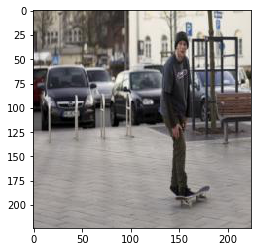

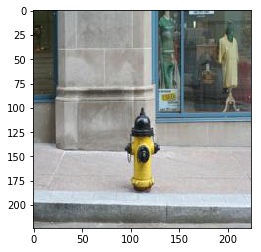

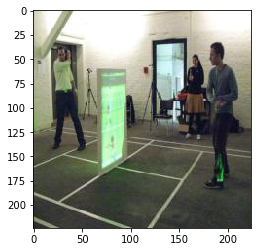

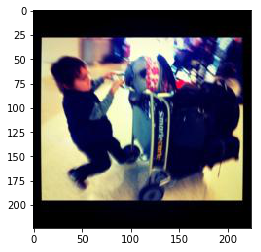

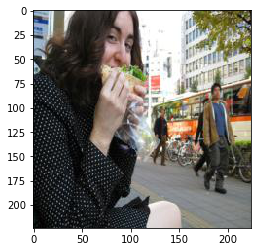

...

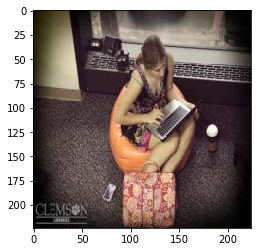

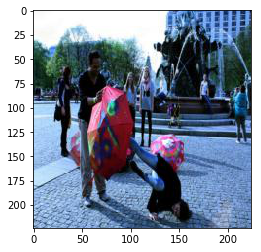

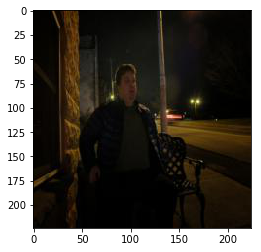

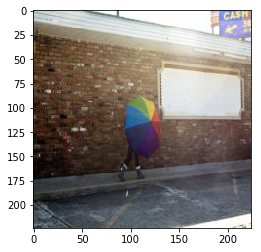

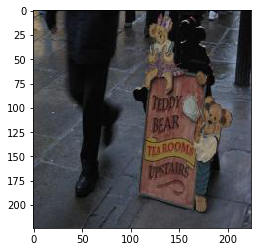

larg slice angel food cake sit top plate small plate contain larg slice cake quarter cake plate larg piec yellow cake sit plate larg slab spong cake sit upon floweri plate ['1654.jpg', '1867.jpg', '1476.jpg', '1812.jpg', '1230.jpg', '30.jpg', '1596.jpg', '1646.jpg', '509.jpg', '482.jpg', '1177.jpg', '14.jpg', '1448.jpg', '1598.jpg', '1071.jpg', '1479.jpg', '1999.jpg', '758.jpg', '1772.jpg', '631.jpg']


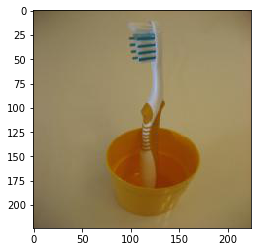

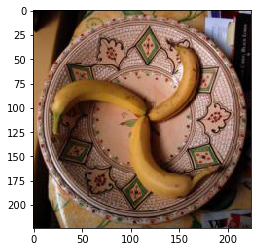

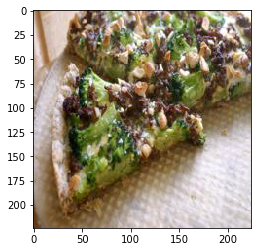

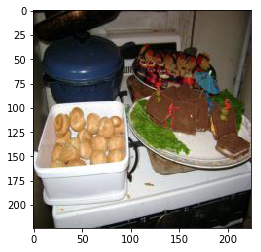

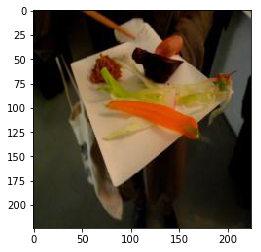

...

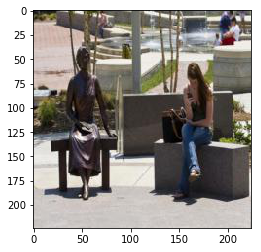

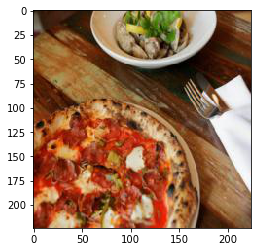

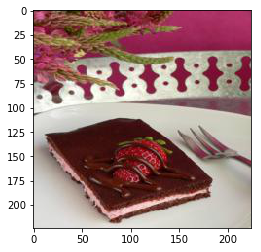

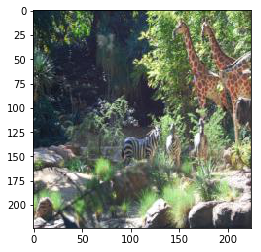

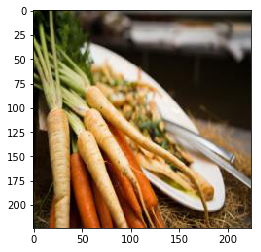

group traffic light sit intersect sign shine street light pictur stoplight window sun surround airplan traffic light sever street light airplan fli overhead ['598.jpg', '393.jpg', '1954.jpg', '557.jpg', '1955.jpg', '1471.jpg', '101.jpg', '158.jpg', '114.jpg', '1183.jpg', '1368.jpg', '1292.jpg', '1840.jpg', '1927.jpg', '883.jpg', '1033.jpg', '763.jpg', '1089.jpg', '1865.jpg', '1664.jpg']


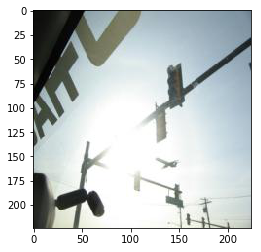

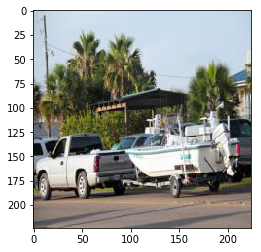

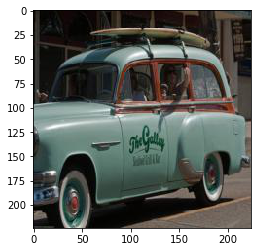

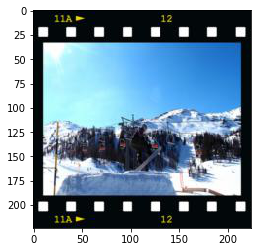

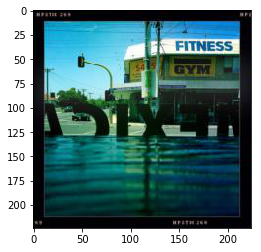

...

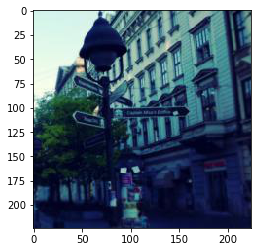

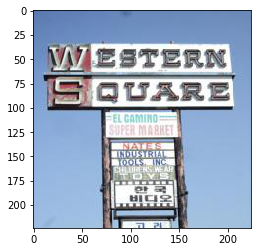

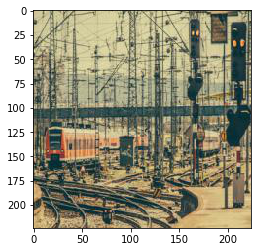

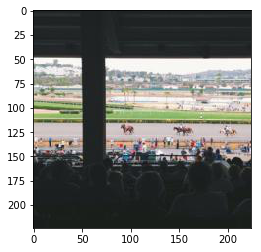

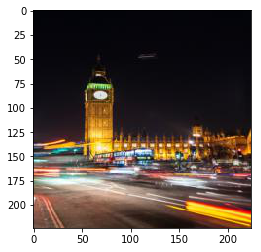

two mean uniform ride hors side side sandi beach two polic offic hors ride beach two peopl ride hors middl lot pair polic offic ride hors beach two peopl neon vest ride hors beach ['478.jpg', '136.jpg', '1627.jpg', '1748.jpg', '349.jpg', '77.jpg', '725.jpg', '1668.jpg', '1171.jpg', '1148.jpg', '1382.jpg', '1848.jpg', '1457.jpg', '1394.jpg', '788.jpg', '337.jpg', '557.jpg', '1879.jpg', '857.jpg', '140.jpg']


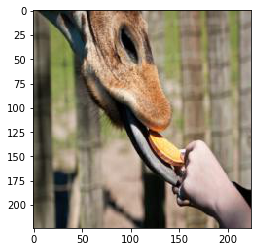

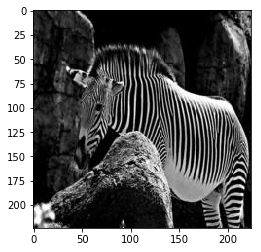

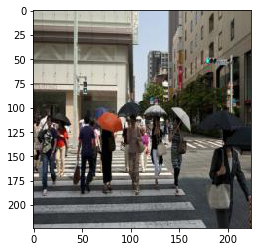

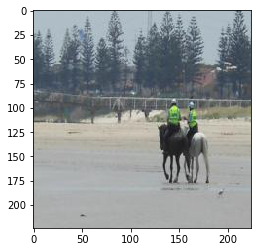

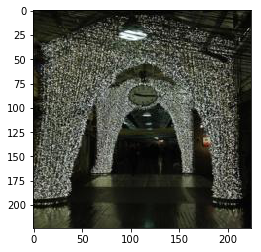

...

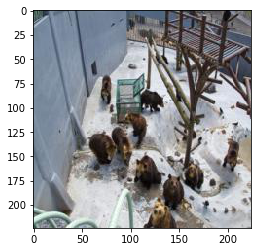

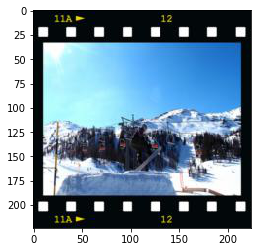

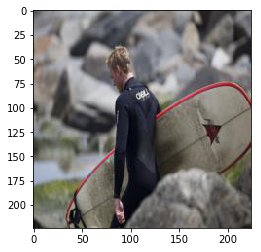

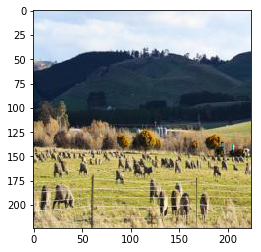

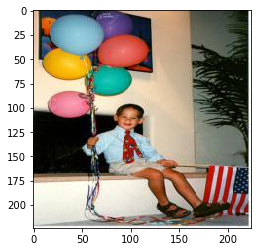

man woman use pay phone adjac booth adult use pay telephon outdoor stand next soda machin coupl peopl phone stand togeth man woman talk public pay phone coupl peopl talk phone ['1442.jpg', '714.jpg', '1479.jpg', '292.jpg', '152.jpg', '1480.jpg', '21.jpg', '1919.jpg', '413.jpg', '1691.jpg', '1738.jpg', '1354.jpg', '736.jpg', '359.jpg', '1219.jpg', '760.jpg', '309.jpg', '487.jpg', '105.jpg', '1663.jpg']


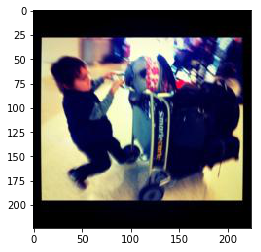

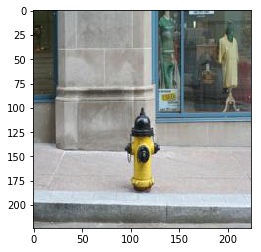

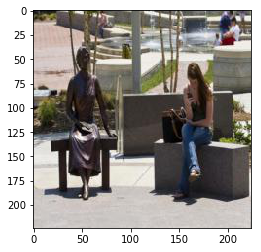

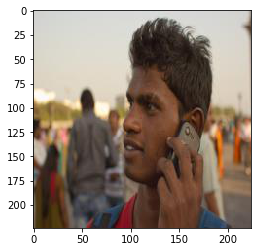

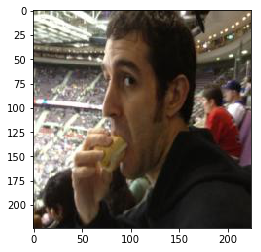

...

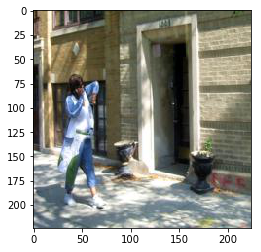

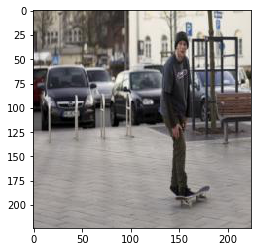

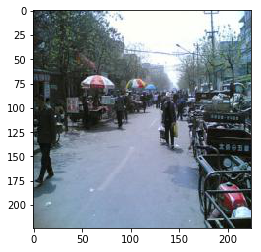

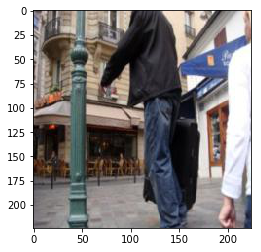

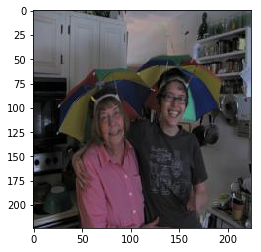

man trick skateboard skateboard trick air wooden ramp blue sky cloud background person perform trick skateboard skateboard jump ramp man jump skateboard park ['845.jpg', '643.jpg', '1700.jpg', '753.jpg', '881.jpg', '330.jpg', '1335.jpg', '1041.jpg', '814.jpg', '127.jpg', '1693.jpg', '492.jpg', '1848.jpg', '616.jpg', '1088.jpg', '1529.jpg', '1991.jpg', '413.jpg', '1296.jpg', '887.jpg']


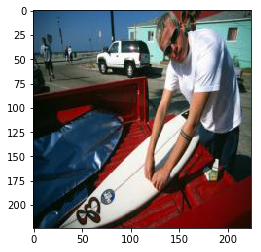

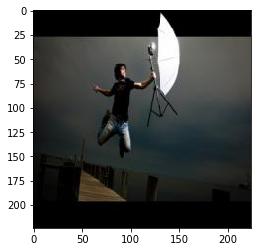

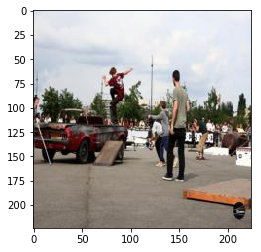

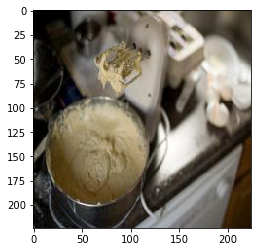

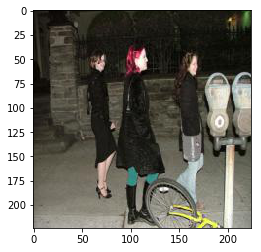

...

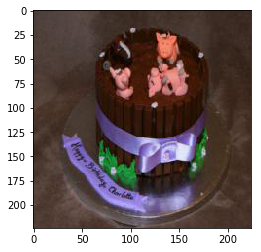

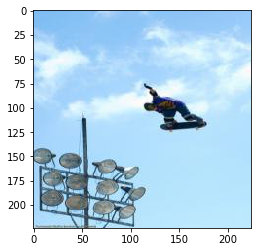

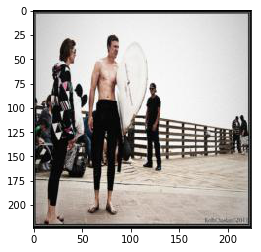

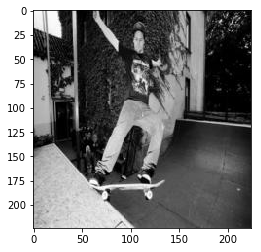

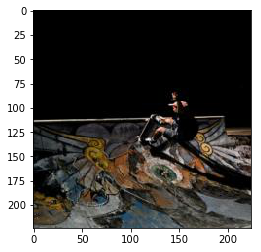

person ski air person jump air pair ski person get airborn ski slope skier trick air skier mid air slope ['1815.jpg', '1790.jpg', '1874.jpg', '1496.jpg', '557.jpg', '429.jpg', '693.jpg', '1195.jpg', '1701.jpg', '1607.jpg', '1541.jpg', '996.jpg', '1275.jpg', '753.jpg', '1216.jpg', '1088.jpg', '1377.jpg', '1122.jpg', '217.jpg', '1472.jpg']


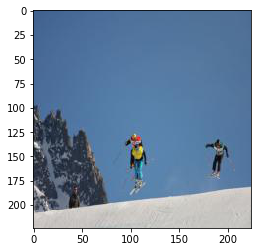

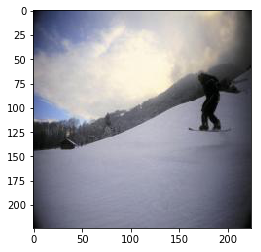

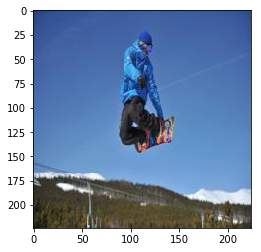

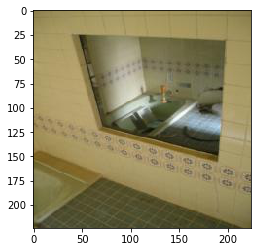

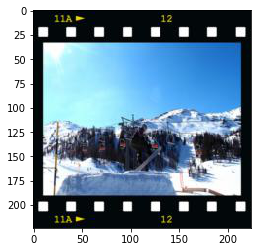

...

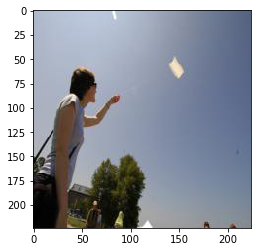

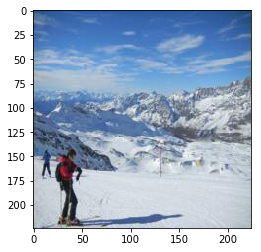

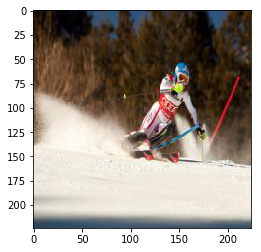

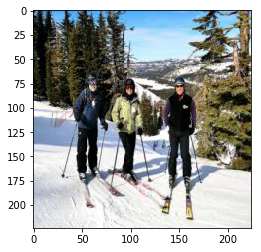

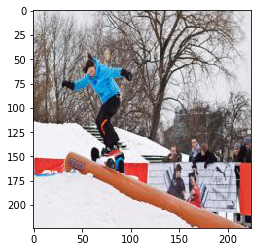

man stand next zebra lawn guy show zebra build young man pose next zebra grassi wildlif exhibit man stand next zebra grass man stand next zebra gestur toward ['1179.jpg', '689.jpg', '1305.jpg', '976.jpg', '279.jpg', '1971.jpg', '756.jpg', '895.jpg', '138.jpg', '136.jpg', '1509.jpg', '1442.jpg', '1922.jpg', '1530.jpg', '1223.jpg', '987.jpg', '1479.jpg', '364.jpg', '339.jpg', '95.jpg']


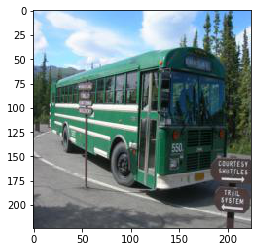

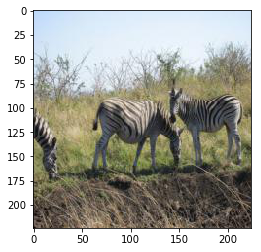

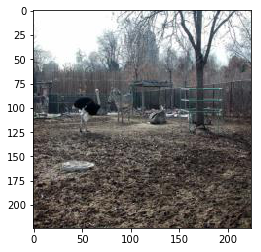

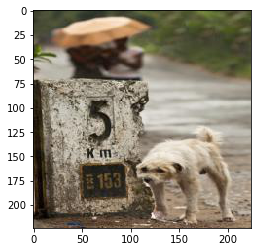

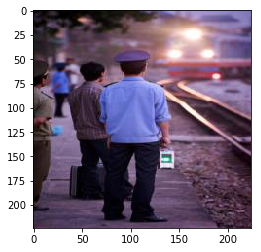

...

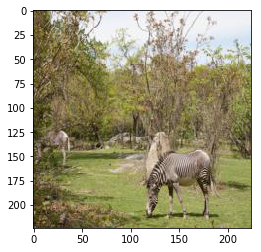

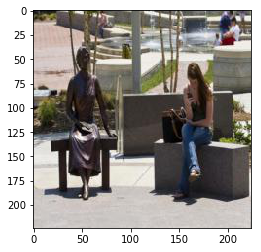

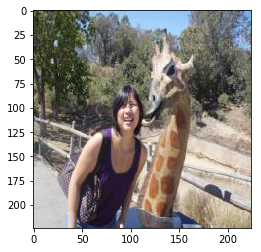

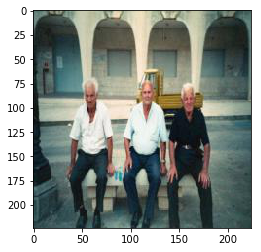

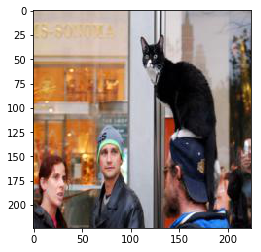

orang fire truck park wharehous antiqu truck display work garag red fire engin park fire station red fire engin insid build old model fire truck sat alon room ['1954.jpg', '449.jpg', '1543.jpg', '1412.jpg', '1031.jpg', '475.jpg', '1570.jpg', '785.jpg', '1830.jpg', '431.jpg', '103.jpg', '531.jpg', '1618.jpg', '388.jpg', '1253.jpg', '405.jpg', '208.jpg', '1971.jpg', '1948.jpg', '496.jpg']


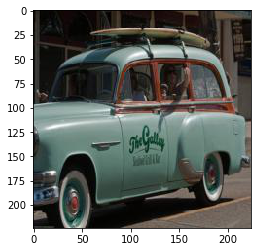

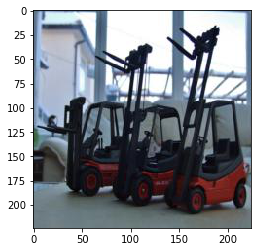

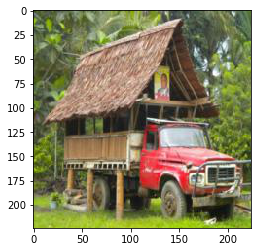

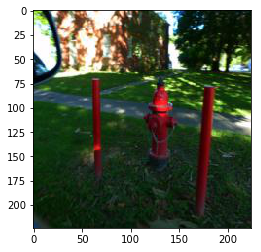

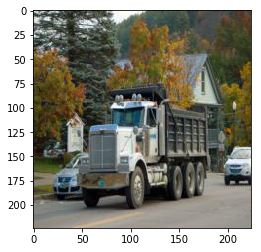

...

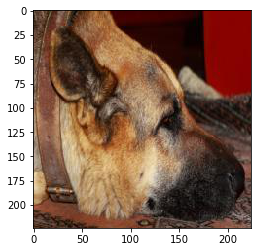

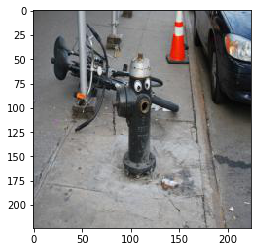

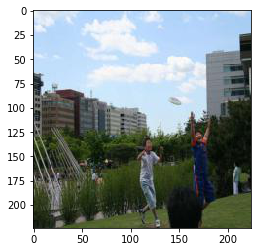

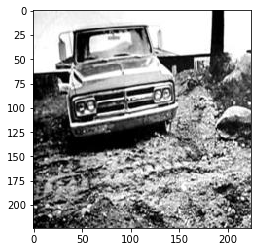

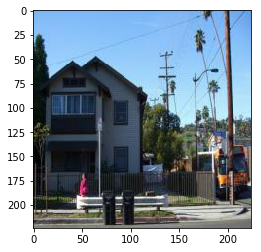

peopl stand skateboard group skateboard stand top ramp skateboard rest top ramp four boy stand readi skateboard four skateboard stand top ramp board readi skate guy stand top ramp skateboad ['29.jpg', '1568.jpg', '351.jpg', '1848.jpg', '753.jpg', '1789.jpg', '614.jpg', '1700.jpg', '321.jpg', '1971.jpg', '526.jpg', '1691.jpg', '940.jpg', '492.jpg', '1335.jpg', '28.jpg', '1818.jpg', '77.jpg', '413.jpg', '639.jpg']


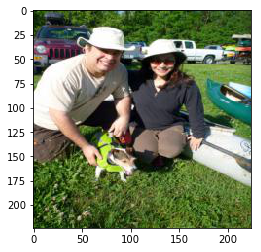

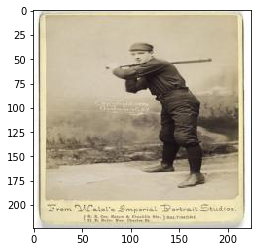

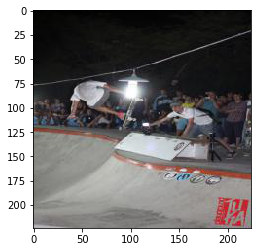

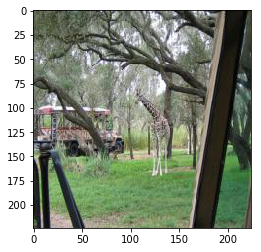

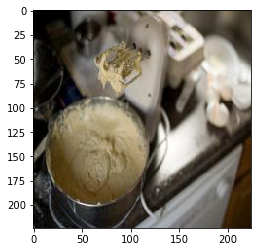

...

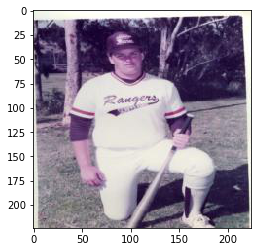

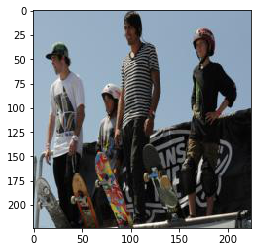

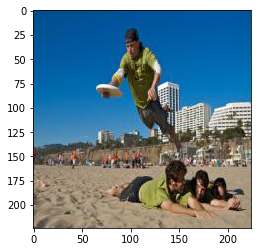

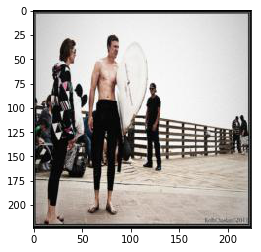

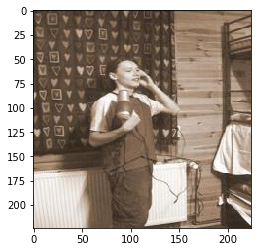

In [222]:
def get_top_20_images_desc(desc_feat):
    feat_scores = {}
    top_images = []

    for label, agg_desc_feat in test_label_agg_desc.items():
        score = get_dist(desc_feat, agg_desc_feat)
        # test image label to its l2 distance of desc feat to agg desc feat
        feat_scores[label] = score
    # get top 20 test images based score computed from L2 distance    
    sorted_feat_score = sorted(feat_scores.items(), key=operator.itemgetter(1))
    for k, v in sorted_feat_score[:20]:
        top_images.append(k.split('/')[1])
    return top_images
        
for i, desc_feat in enumerate(test_desc_feat[:10]):
    top = get_top_20_images_desc(desc_feat)
    print(test_desc[i], top)
    for image in top:
        img = Image.open('data/images_test/' + image)
        img = np.asarray(img)
        plt.imshow(img)
        plt.show()            

In [223]:
write_submissions('sample_submission.csv', True)